# Theoretical Background

Differential Equation 


$$\frac{\partial u}{\partial t} + c \frac{\partial u}{\partial x} = 0$$

where u = u(x, t) -- oscillating quantity, e.g., displacement.

Describes a wave moving to the right with velocity $c$.

Burgers' wave equation

$$\frac{\partial u}{\partial t} + \varepsilon u \frac{\partial u}{\partial x} = 0$$

describes nonlinear movement, where velocity $c = const \cdot u$ so depends on the amplitude.

Lets rewrite it.

We use that
$$u \frac{\partial u}{\partial x} = \frac{\partial u^2}{2 \partial x}$$
and approximate partial derivatives by central differences

$$\frac{ u(x, t+\Delta t) - u(x, t-\Delta t)}{2\Delta t} + \varepsilon \frac{u^2(x+\Delta x, t) - u^2(x - \Delta x, t)}{4 \Delta x} = 0$$

$$u(x, t+\Delta t) = u(x, t-\Delta t) - \frac{\Delta t \varepsilon}{\Delta x} \frac{u^2(x+\Delta x, t) - u^2(x - \Delta x, t)}{2}$$


$$u_{i, j+1} = u_{i, j-1} - \beta \frac{u^2_{i+1, j} - u^2_{i-1, j}}{2}$$

where $\beta := \frac{\Delta t \varepsilon}{\Delta x}$ , and  $u_{i, j} := u(x_0+i\cdot \Delta x, t_0 + j\cdot \Delta t)$

Another more accurate method called Lax-Wendroff adds higher order terms and lead to equation

$$
\begin{aligned}
u_{i, j+1} & =u_{i, j}-\frac{\beta}{4}\left(u_{i+1, j}^2-u_{i-1, j}^2\right) \\
& +\frac{\beta^2}{8}\left[\left(u_{i+1, j}-u_{i, j}\right)\left(u_{i+1, j}^2-u_{i, j}^2\right)-\left(u_{i, j}-u_{i-1, j}\right)\left(u_{i, j}^2-u_{i-1, j}^2\right) .\right]
\end{aligned}
$$

In this work Burgers' equation is solved numerically by the last equation (Lax-Wendroff method) with different initial conditions. Results are visualized

In [1]:
import numpy as np
import matplotlib.pyplot as plt

# Simulation

In [2]:
def simulate(u0, u1, beta, n_steps):
    """Takes two arrays of system state on steps 0 and 1 and returns
    an array of system state on steps 2, 3, etc.
    beta -- CFL number
    """

    assert len(u0) == len(u1)
    assert np.sum(np.abs([u0[0], u1[0], u0[-1], u1[-1]])) < 10e-10  # boundary conditions

    # for this algorithm u1 is not required, but for generality I will keep it as argument

    m = len(u0)
    results = np.zeros((n_steps, m))
    results[0] = u0
    results[1] = u1

    for step in range(1, n_steps-1):
        results[step+1, 1:-1] =  results[step, 1:-1]  - beta/4 * (
            results[step, 2:]**2 -  results[step, :-2]**2
        ) + beta**2/8 * (
            (results[step, 2:] - results[step, 1:-1])*(results[step, 2:]**2 - results[step, 1:-1]**2) -
            (results[step, :-2] - results[step, 1:-1])*(results[step, :-2]**2 - results[step, 1:-1]**2)
        )
    return results

b) Running from initial conditions of simple 1-st mode wave

In [3]:
m = 100
x = np.linspace(0, 1, m)
u0 = 3*np.sin(3.2*x)
u1 = 3*np.sin(3.2*x)
# initially velocity is 0, so u0 and u1 are equal
u0[[0, -1]] = 0
u1[[0, -1]] = 0
# for some dt beta=0.5 will give the speed c
# to be precise dx = 1/100, eps = c/u_max = 1/3, dt = beta/eps*dx = 0.5*3*0.01 = 0.015

results = simulate(u0, u1, 0.5, 100)

/tmp/ipykernel_34387/2106326675.py:21: RuntimeWarning: overflow encountered in multiply
  (results[step, 2:] - results[step, 1:-1])*(results[step, 2:]**2 - results[step, 1:-1]**2) -
/tmp/ipykernel_34387/2106326675.py:22: RuntimeWarning: overflow encountered in multiply
  (results[step, :-2] - results[step, 1:-1])*(results[step, :-2]**2 - results[step, 1:-1]**2)
/tmp/ipykernel_34387/2106326675.py:21: RuntimeWarning: invalid value encountered in subtract
  (results[step, 2:] - results[step, 1:-1])*(results[step, 2:]**2 - results[step, 1:-1]**2) -
/tmp/ipykernel_34387/2106326675.py:19: RuntimeWarning: invalid value encountered in subtract
  results[step, 2:]**2 -  results[step, :-2]**2
/tmp/ipykernel_34387/2106326675.py:18: RuntimeWarning: invalid value encountered in add
  results[step+1, 1:-1] =  results[step, 1:-1]  - beta/4 * (


e) plotting on the same graph

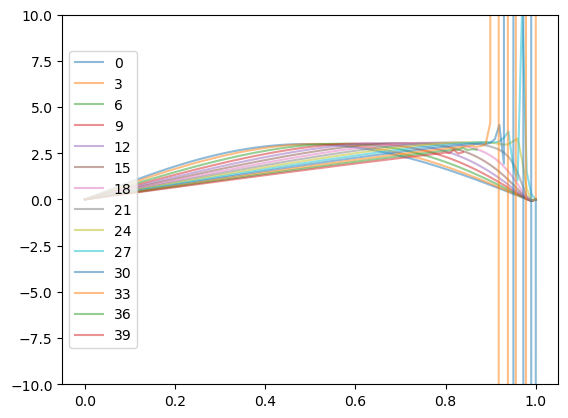

In [4]:
for s in range(0, 40, 3):
    plt.plot(x, results[s], label=s, alpha=0.5)
plt.ylim(-10, 10)
plt.legend(loc="center left")
plt.show()

### Tests

So as we can see, something like shock wave appears on the right side of the box. It is hard to test such simulator, as no exact solution is known for this equation. So we have nothing to compare with. But at least we can ran simulation with different parameters to make some health checks. 

For example check that with decreasing time step, solution converges to come finite solution.

In [5]:
# scale dt

m = 100
x = np.linspace(0, 1, m)
u0 = 3*np.sin(np.pi*x)
u1 = 3*np.sin(np.pi*x)

runs = []
scales = [1, 2, 4, 8]
for scale in scales:
    results = simulate(u0, u1, 0.5/scale, 40*scale)
    runs.append(results)

/tmp/ipykernel_34387/2106326675.py:21: RuntimeWarning: overflow encountered in multiply
  (results[step, 2:] - results[step, 1:-1])*(results[step, 2:]**2 - results[step, 1:-1]**2) -
/tmp/ipykernel_34387/2106326675.py:22: RuntimeWarning: overflow encountered in multiply
  (results[step, :-2] - results[step, 1:-1])*(results[step, :-2]**2 - results[step, 1:-1]**2)
/tmp/ipykernel_34387/2106326675.py:21: RuntimeWarning: invalid value encountered in subtract
  (results[step, 2:] - results[step, 1:-1])*(results[step, 2:]**2 - results[step, 1:-1]**2) -
/tmp/ipykernel_34387/2106326675.py:19: RuntimeWarning: overflow encountered in square
  results[step, 2:]**2 -  results[step, :-2]**2
/tmp/ipykernel_34387/2106326675.py:19: RuntimeWarning: invalid value encountered in subtract
  results[step, 2:]**2 -  results[step, :-2]**2
/tmp/ipykernel_34387/2106326675.py:21: RuntimeWarning: overflow encountered in square
  (results[step, 2:] - results[step, 1:-1])*(results[step, 2:]**2 - results[step, 1:-1]*

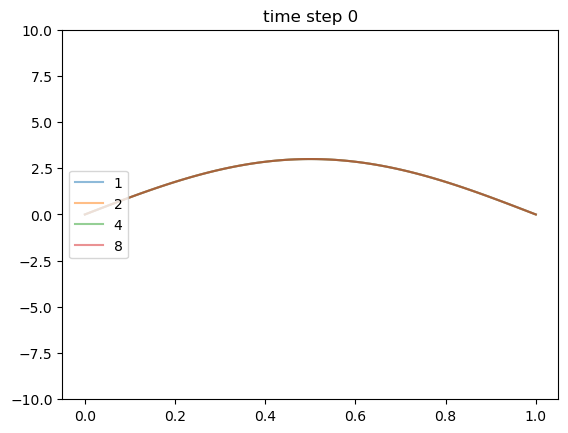

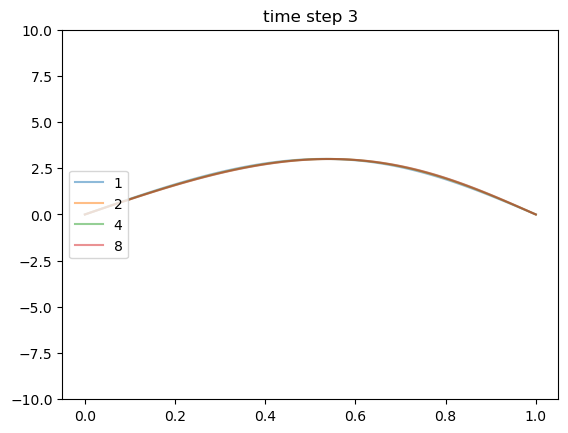

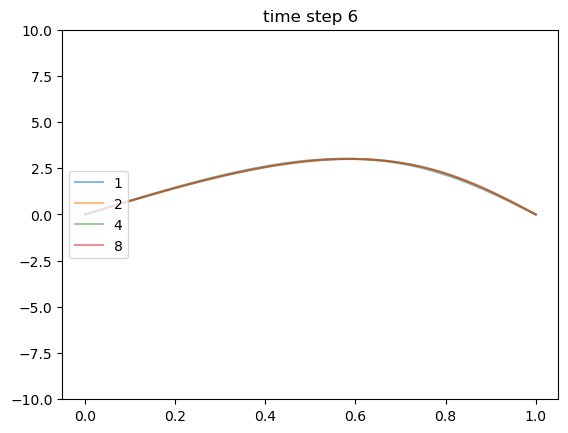

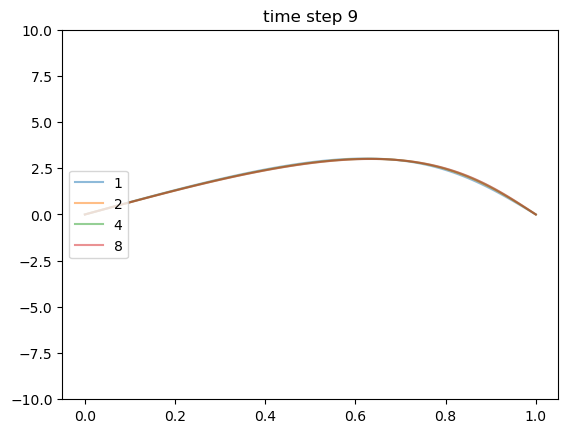

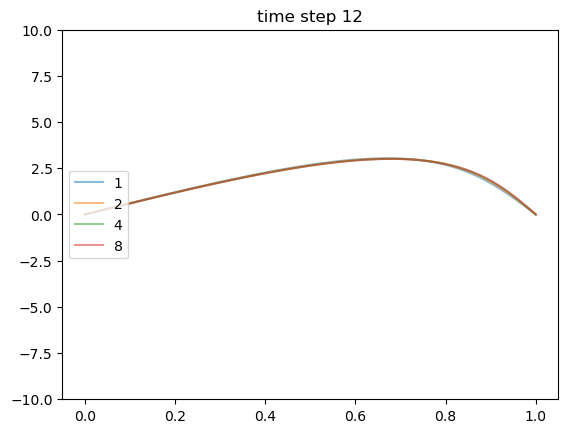

...

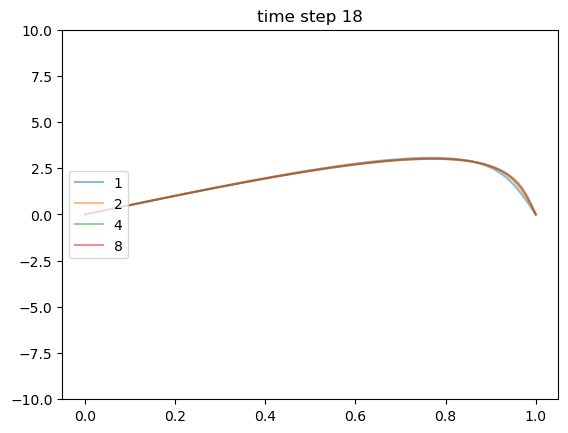

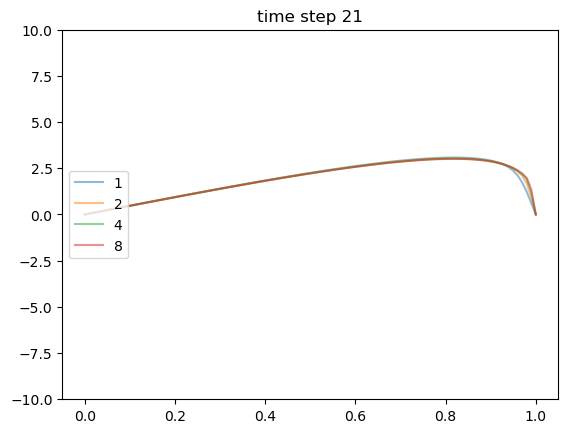

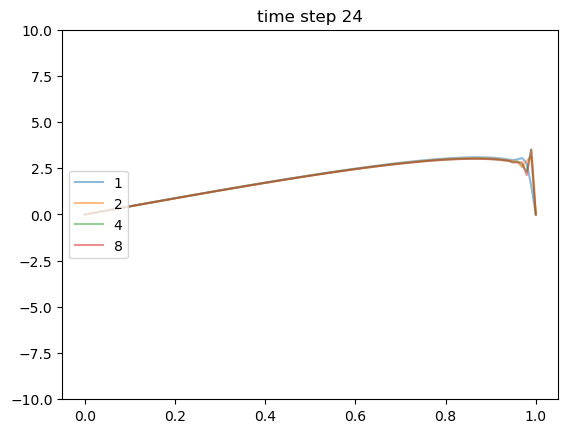

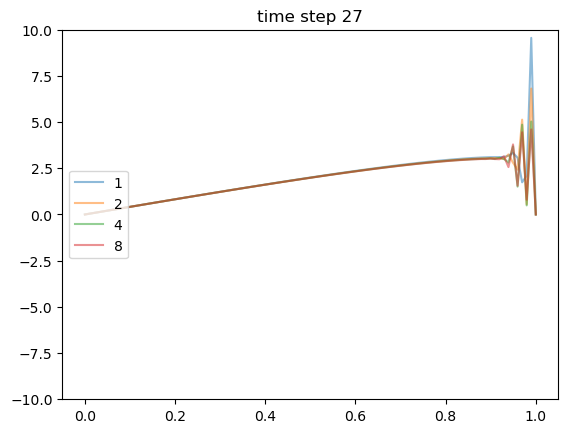

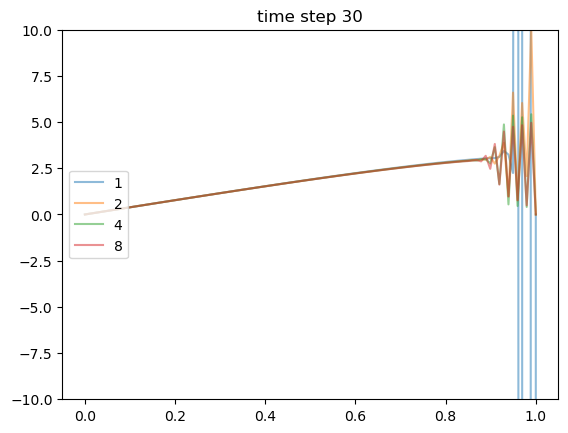

In [6]:

for s in range(0, 33, 3):
    for i, scale in enumerate(scales):
        plt.plot(x, runs[i][s*scale], label=scale, alpha=0.5)
    plt.ylim(-10, 10)
    plt.legend(loc="center left")
    plt.title(f"time step {s}")
    plt.show()

In general solution converges with decreasing time step, but when the shock wave appears, $u$ begins in change very rapidly with x step, and it is no longer possible to use such naive approximations of derivatives. In fact solutions for all dt-s eventually lose sense.

In [7]:
%matplotlib notebook

In [8]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

def animate_timeseries(function_series, interval=200, title=""):



    def animate(i):
        plt.cla()  # Clear the plot
        plt.plot(function_series[i])  # Plot the current function values
        plt.title(title)  # Set the title with the current time step
        # plt.xlim(0, len(results[0]) - 1)  # Set the x-axis limits
        plt.ylim(-10, 10)  # Set the y-axis limits
        plt.draw()  # Redraw the plot

    # Create the animation figure and artist
    fig = plt.figure()

    # Animate the function values over the time steps
    ani = FuncAnimation(fig, animate, interval=interval, frames=len(function_series))

    return ani

## f) Stability condition

Check that beta < 1 is require for solution to be stable.

In [26]:
betas = [0.5, 0.95, 1, 1.05, 1.5, 3, 10, 0.03]

m = 100
x = np.linspace(0, 1, m)
u0 = 3*np.sin(np.pi*x)
u1 = 3*np.sin(np.pi*x)

runs = []
for b in betas:
    results = simulate(u0, u1, b, int(40*2/b+1))
    runs.append(results)


/tmp/ipykernel_34387/2106326675.py:21: RuntimeWarning: overflow encountered in multiply
  (results[step, 2:] - results[step, 1:-1])*(results[step, 2:]**2 - results[step, 1:-1]**2) -
/tmp/ipykernel_34387/2106326675.py:22: RuntimeWarning: overflow encountered in multiply
  (results[step, :-2] - results[step, 1:-1])*(results[step, :-2]**2 - results[step, 1:-1]**2)
/tmp/ipykernel_34387/2106326675.py:21: RuntimeWarning: invalid value encountered in subtract
  (results[step, 2:] - results[step, 1:-1])*(results[step, 2:]**2 - results[step, 1:-1]**2) -
/tmp/ipykernel_34387/2106326675.py:19: RuntimeWarning: overflow encountered in square
  results[step, 2:]**2 -  results[step, :-2]**2
/tmp/ipykernel_34387/2106326675.py:19: RuntimeWarning: invalid value encountered in subtract
  results[step, 2:]**2 -  results[step, :-2]**2
/tmp/ipykernel_34387/2106326675.py:21: RuntimeWarning: overflow encountered in square
  (results[step, 2:] - results[step, 1:-1])*(results[step, 2:]**2 - results[step, 1:-1]*

In [10]:
i = 0
b = betas[i]
ani = animate_timeseries(runs[i], 200*b, title=f"beta = {b}")
print("Beta = ", b)
HTML(ani.to_jshtml())

<IPython.core.display.Javascript object>

Beta =  0.5


In [11]:
i = 1
b = betas[i]
ani = animate_timeseries(runs[i], 200*b, title=f"beta = {b}")
print("Beta = ", b)
HTML(ani.to_jshtml())

<IPython.core.display.Javascript object>

Beta =  0.95


In [12]:
i = 2
b = betas[i]
ani = animate_timeseries(runs[i], 200*b, title=f"beta = {b}")
print("Beta = ", b)
HTML(ani.to_jshtml())

<IPython.core.display.Javascript object>

Beta =  1


In [13]:
i = 3
b = betas[i]
ani = animate_timeseries(runs[i], 200*b, title=f"beta = {b}")
print("Beta = ", b)
HTML(ani.to_jshtml())

<IPython.core.display.Javascript object>

Beta =  1.05


In [14]:
i = 4
b = betas[i]
ani = animate_timeseries(runs[i], 200*b, title=f"beta = {b}")
print("Beta = ", b)
HTML(ani.to_jshtml())

<IPython.core.display.Javascript object>

Beta =  1.5


In [15]:
i = 5
b = betas[i]
ani = animate_timeseries(runs[i], 200*b, title=f"beta = {b}")
print("Beta = ", b)
HTML(ani.to_jshtml())

<IPython.core.display.Javascript object>

Beta =  3


In [16]:
i = 6
b = betas[i]
ani = animate_timeseries(runs[i], 200*b, title=f"beta = {b}")
print("Beta = ", b)
HTML(ani.to_jshtml())

<IPython.core.display.Javascript object>

Beta =  10


In [31]:
i = 7
b = betas[i]
ani = animate_timeseries(runs[i][:int(len(runs[i])/2.3):16], 16*200*b, title=f"beta = {b}")  # only every 16th to reduce file size
print("Beta = ", b)
HTML(ani.to_jshtml())

<IPython.core.display.Javascript object>

Beta =  0.03


### Tests again. Comparing to first order simulation

In [33]:
def simulate_simple(u0, u1, beta, n_steps):
    """Takes two arrays of system state on steps 0 and 1 and returns
    an array of system state on steps 2, 3, etc.
    beta -- CFL number
    """

    assert len(u0) == len(u1)
    assert np.sum(np.abs([u0[0], u1[0], u0[-1], u1[-1]])) < 10e-10  # boundary conditions

    m = len(u0)
    results = np.zeros((n_steps, m))
    results[0] = u0
    results[1] = u1

    for step in range(1, n_steps-1):
        results[step+1, 1:-1] =  results[step-1, 1:-1]  - beta/2 * (
            results[step, 2:]**2 -  results[step, :-2]**2
        )
    return results

In [34]:
betas = [0.1, 0.9, 1, 3, 10]

m = 100
x = np.linspace(0, 1, m)
u0 = 3*np.sin(np.pi*x)
u1 = 3*np.sin(np.pi*x)

runs = []
for b in betas:
    results = simulate_simple(u0, u1, b, int(40*2/b+1))
    runs.append(results)


/tmp/ipykernel_34387/1805547950.py:17: RuntimeWarning: overflow encountered in square
  results[step, 2:]**2 -  results[step, :-2]**2
/tmp/ipykernel_34387/1805547950.py:17: RuntimeWarning: invalid value encountered in subtract
  results[step, 2:]**2 -  results[step, :-2]**2


In [35]:
i = 0
b = betas[i]
ani = animate_timeseries(runs[i][::8], 8*200*b, title=f"beta = {b}")
print("Beta = ", b)
HTML(ani.to_jshtml())

<IPython.core.display.Javascript object>

Beta =  0.1


In [21]:
for i in range(1, len(betas)):
    b = betas[i]
    ani = animate_timeseries(runs[i], 200*b, title=f"beta = {b}")
    print("Beta = ", b)
    display(HTML(ani.to_jshtml()))

<IPython.core.display.Javascript object>

Beta =  0.9


<IPython.core.display.Javascript object>

Beta =  1


<IPython.core.display.Javascript object>

Beta =  3


<IPython.core.display.Javascript object>

Beta =  10


As we can see, for simpler simulation $\beta$ <1 can be used as an approximate stability criterion, because for bigger $\beta$ solutions diverge even in regions far from border. While $\beta = 0.1$ gives a smooth movement in these regions without oscillations.

Nevertheless $\beta=0.9$ also gives a divergence of the solution far from border, so this criterion is not exact.


But it is good sign that simpler model gives results consistent with results from Lax-Wendroff method.

### Tests. Another initial wave shape

In [22]:
u0 = 3*np.sin(2*np.pi*x)
u1 = 3*np.sin(2*np.pi*x)

b = 0.5
results = simulate(u0, u1, b, int(40*2/b+1))
ani = animate_timeseries(results, 200*b, title=f"beta = {b}")
print("Beta = ", b)
HTML(ani.to_jshtml())

/tmp/ipykernel_34387/2106326675.py:21: RuntimeWarning: overflow encountered in multiply
  (results[step, 2:] - results[step, 1:-1])*(results[step, 2:]**2 - results[step, 1:-1]**2) -
/tmp/ipykernel_34387/2106326675.py:22: RuntimeWarning: overflow encountered in multiply
  (results[step, :-2] - results[step, 1:-1])*(results[step, :-2]**2 - results[step, 1:-1]**2)
/tmp/ipykernel_34387/2106326675.py:21: RuntimeWarning: invalid value encountered in subtract
  (results[step, 2:] - results[step, 1:-1])*(results[step, 2:]**2 - results[step, 1:-1]**2) -
/tmp/ipykernel_34387/2106326675.py:19: RuntimeWarning: overflow encountered in square
  results[step, 2:]**2 -  results[step, :-2]**2
/tmp/ipykernel_34387/2106326675.py:19: RuntimeWarning: invalid value encountered in subtract
  results[step, 2:]**2 -  results[step, :-2]**2
/tmp/ipykernel_34387/2106326675.py:18: RuntimeWarning: invalid value encountered in subtract
  results[step+1, 1:-1] =  results[step, 1:-1]  - beta/4 * (
/tmp/ipykernel_34387

<IPython.core.display.Javascript object>

Beta =  0.5


In [23]:
u0 = 3*np.sin(3*np.pi*x)
u1 = 3*np.sin(3*np.pi*x)

b = 0.5
results = simulate(u0, u1, b, int(40*2/b+1))
ani = animate_timeseries(results, 200*b, title=f"beta = {b}")
print("Beta = ", b)
HTML(ani.to_jshtml())

/tmp/ipykernel_34387/2106326675.py:21: RuntimeWarning: overflow encountered in multiply
  (results[step, 2:] - results[step, 1:-1])*(results[step, 2:]**2 - results[step, 1:-1]**2) -
/tmp/ipykernel_34387/2106326675.py:22: RuntimeWarning: overflow encountered in multiply
  (results[step, :-2] - results[step, 1:-1])*(results[step, :-2]**2 - results[step, 1:-1]**2)
/tmp/ipykernel_34387/2106326675.py:21: RuntimeWarning: invalid value encountered in subtract
  (results[step, 2:] - results[step, 1:-1])*(results[step, 2:]**2 - results[step, 1:-1]**2) -
/tmp/ipykernel_34387/2106326675.py:19: RuntimeWarning: invalid value encountered in subtract
  results[step, 2:]**2 -  results[step, :-2]**2
/tmp/ipykernel_34387/2106326675.py:18: RuntimeWarning: invalid value encountered in add
  results[step+1, 1:-1] =  results[step, 1:-1]  - beta/4 * (
/tmp/ipykernel_34387/2106326675.py:19: RuntimeWarning: overflow encountered in square
  results[step, 2:]**2 -  results[step, :-2]**2
/tmp/ipykernel_34387/2106

<IPython.core.display.Javascript object>

Beta =  0.5


In [24]:
# the same initial conditions with simpler simulation

u0 = 3*np.sin(3*np.pi*x)
u1 = 3*np.sin(3*np.pi*x)

b = 0.5
results = simulate_simple(u0, u1, b, int(40*2/b+1))
ani = animate_timeseries(results, 200*b, title=f"beta = {b}")
print("Beta = ", b)
HTML(ani.to_jshtml())

/tmp/ipykernel_34387/1805547950.py:17: RuntimeWarning: overflow encountered in square
  results[step, 2:]**2 -  results[step, :-2]**2
/tmp/ipykernel_34387/1805547950.py:17: RuntimeWarning: invalid value encountered in subtract
  results[step, 2:]**2 -  results[step, :-2]**2


<IPython.core.display.Javascript object>

Beta =  0.5


So again consistency. Then simulation seems to work correct.